In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px


In [2]:
df = pd.read_excel('local/data/compras.xlsx')
print(df.shape)

(58693, 23)


## **Limpieza de Datos**
Vamos a estandatizar los nombres de las columnas 

In [3]:
df.columns = df.columns.str.replace(' ', '_')
df.columns = df.columns.str.strip()
df.columns = df.columns.str.lower()


Vamos a verificar que no existan valores faltantes, si bien en el archivo se indica que fueron tratados.

In [4]:
df.isna().sum()

id                    0
dia                   0
incidencia            0
marca                 0
cantidad              0
ultima_venta_marca    0
precio_1              0
precio_2              0
precio_3              0
precio_4              0
precio_5              0
promocion_1           0
promocion_2           0
promocion_3           0
promocion_4           0
promocion_5           0
sexo                  0
estado_civil          0
edad                  0
educacion             0
ingreso               0
ocupacion             0
tamaño_ciudad         0
dtype: int64

Estudiemos el tipo de datos que vamos a analizar

In [5]:
df.dtypes

id                      int64
dia                     int64
incidencia              int64
marca                   int64
cantidad                int64
ultima_venta_marca      int64
precio_1              float64
precio_2              float64
precio_3              float64
precio_4              float64
precio_5              float64
promocion_1             int64
promocion_2             int64
promocion_3             int64
promocion_4             int64
promocion_5             int64
sexo                    int64
estado_civil            int64
edad                    int64
educacion               int64
ingreso                 int64
ocupacion               int64
tamaño_ciudad           int64
dtype: object

Calculemos algunos descriptivos de las variables para entender el compartamiento de estas

In [6]:
df.describe()

,id,dia,incidencia,marca,cantidad,ultima_venta_marca,precio_1,precio_2,precio_3,precio_4,...,promocion_3,promocion_4,promocion_5,sexo,estado_civil,edad,educacion,ingreso,ocupacion,tamaño_ciudad
count,5.869300e+04,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,...,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000,58693.000000
mean,2.000003e+08,349.431074,0.249399,0.844309,0.691973,0.840799,1.392074,1.780999,2.006789,2.159945,...,0.042799,0.117851,0.035865,0.385889,0.393113,38.793962,1.101579,121841.644319,0.774198,0.655904
std,1.443167e+02,212.045058,0.432669,1.633083,1.498734,1.631628,0.091139,0.170868,0.046867,0.089825,...,0.202405,0.322434,0.185954,0.486809,0.488446,12.052447,0.652499,40643.740678,0.663247,0.794162
min,2.000000e+08,1.000000,0.000000,0.000000,0.000000,0.000000,1.100000,1.260000,1.870000,1.760000,...,0.000000,0.000000,0.000000,0.000000,0.000000,18.000000,0.000000,38247.000000,0.000000,0.000000
25%,2.000001e+08,161.000000,0.000000,0.000000,0.000000,0.000000,1.340000,1.580000,1.970000,2.120000,...,0.000000,0.000000,0.000000,0.000000,0.000000,30.000000,1.000000,95541.000000,0.000000,0.000000
50%,2.000003e+08,343.000000,0.000000,0.000000,0.000000,0.000000,1.390000,1.880000,2.010000,2.170000,...,0.000000,0.000000,0.000000,0.000000,0.000000,36.000000,1.000000,117971.000000,1.000000,0.000000
75%,2.000004e+08,530.000000,0.000000,0.000000,0.000000,0.000000,1.470000,1.890000,2.060000,2.240000,...,0.000000,0.000000,0.000000,1.000000,1.000000,46.000000,1.000000,138525.000000,1.000000,1.000000
max,2.000005e+08,730.000000,1.000000,5.000000,15.000000,5.000000,1.590000,1.900000,2.140000,2.260000,...,1.000000,1.000000,1.000000,1.000000,1.000000,75.000000,3.000000,309364.000000,2.000000,2.000000


Vamos a transformar las variables 'edad' e 'ingreso' aplicando la función logaritmo para determinar si se pueden normalizar dichas variables.

In [7]:
df['edad_log'] = np.log(df['edad'])
df['ingreso_log'] = np.log(df['ingreso'])

In [8]:
df.head()

,id,dia,incidencia,marca,cantidad,ultima_venta_marca,precio_1,precio_2,precio_3,precio_4,...,promocion_5,sexo,estado_civil,edad,educacion,ingreso,ocupacion,tamaño_ciudad,edad_log,ingreso_log
0,200000001,1,0,0,0,0,1.59,1.87,2.01,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
1,200000001,11,0,0,0,0,1.51,1.89,1.99,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
2,200000001,12,0,0,0,0,1.51,1.89,1.99,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
3,200000001,16,0,0,0,0,1.52,1.89,1.98,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
4,200000001,18,0,0,0,0,1.52,1.89,1.99,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078


In [9]:
df[df['incidencia'] != 0 ]

,id,dia,incidencia,marca,cantidad,ultima_venta_marca,precio_1,precio_2,precio_3,precio_4,...,promocion_5,sexo,estado_civil,edad,educacion,ingreso,ocupacion,tamaño_ciudad,edad_log,ingreso_log
6,200000001,28,1,2,2,0,1.50,1.90,1.99,2.09,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
11,200000001,58,1,5,1,0,1.39,1.90,1.91,2.12,...,1,0,0,47,1,110866,1,0,3.850148,11.616078
19,200000001,110,1,1,2,0,1.47,1.90,1.99,1.97,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
24,200000001,142,1,4,1,0,1.21,1.35,1.99,2.16,...,0,0,0,47,1,110866,1,0,3.850148,11.616078
29,200000001,183,1,2,3,0,1.46,1.88,1.97,1.89,...,1,0,0,47,1,110866,1,0,3.850148,11.616078
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58621,200000500,296,1,2,6,0,1.48,1.89,2.01,2.18,...,0,0,0,42,1,120946,1,0,3.737670,11.703099
58648,200000500,460,1,1,12,0,1.35,1.57,2.02,2.21,...,0,0,0,42,1,120946,1,0,3.737670,11.703099
58674,200000500,641,1,2,7,0,1.50,1.85,2.06,2.24,...,0,0,0,42,1,120946,1,0,3.737670,11.703099
58687,200000500,697,1,2,6,0,1.42,1.51,1.97,2.24,...,0,0,0,42,1,120946,1,0,3.737670,11.703099


## **1. Visualización**

In [10]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(
    rows=5, cols=2,
    subplot_titles = ('Sexo', 'Estado Civil', 
                    'Edad', 'Edad log', 'Ingreso', 'Ingreso log',
                     'Educación', 'Ocupación',
                    'Tamaño de Ciudad'),
    specs=[[{"type": "histogram"}, {"type": "histogram"}],
           [{"type": "histogram"}, {"type": "histogram"}],
           [{"type": "histogram"}, {"type": "histogram"}],
           [{"type": "histogram"}, {"type": "histogram"}],
           [{"type": "histogram"}, {"type": "histogram"}]],
)

fig.add_trace(go.Histogram(x=df['sexo']),
              row=1, col=1)

fig.add_trace(go.Histogram(x = df['estado_civil']),
              row=1, col=2)

fig.add_trace(go.Histogram(x = df['edad']),
              row=2, col=1)

fig.add_trace(go.Histogram(x = df['edad_log']),
              row=2, col=2)

fig.add_trace(go.Histogram(x = df['ingreso']),
              row=3, col=1)

fig.add_trace(go.Histogram(x = df['ingreso_log']),
              row=3, col=2)

fig.add_trace(go.Histogram(x = df['educacion']),
              row=4, col=1)

fig.add_trace(go.Histogram(x = df['ocupacion']),
              row=4, col=2)

fig.add_trace(go.Histogram(x = df['tamaño_ciudad']),
              row=5, col=1)

fig.update_layout(height=1000, showlegend=False)

fig.show()

In [11]:
df.dtypes

id                      int64
dia                     int64
incidencia              int64
marca                   int64
cantidad                int64
ultima_venta_marca      int64
precio_1              float64
precio_2              float64
precio_3              float64
precio_4              float64
precio_5              float64
promocion_1             int64
promocion_2             int64
promocion_3             int64
promocion_4             int64
promocion_5             int64
sexo                    int64
estado_civil            int64
edad                    int64
educacion               int64
ingreso                 int64
ocupacion               int64
tamaño_ciudad           int64
edad_log              float64
ingreso_log           float64
dtype: object

In [12]:
df['estado_civil'].unique()

array([0, 1])

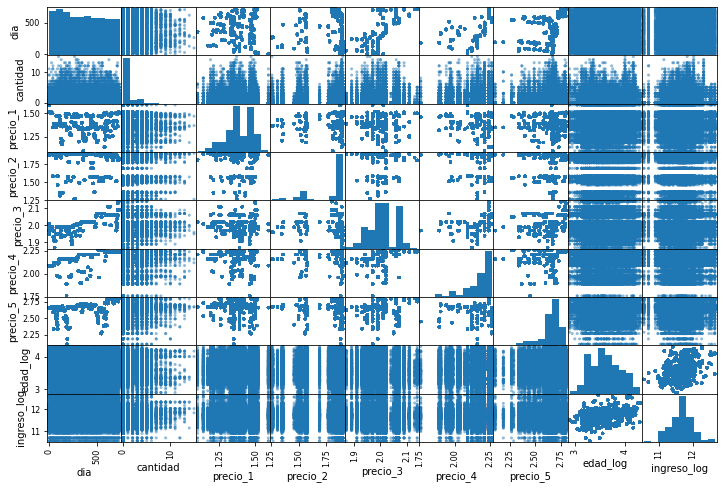

In [13]:
from pandas.plotting import scatter_matrix

attributes = ['dia', 'cantidad','precio_1', 'precio_2', 'precio_3', 'precio_4', 'precio_5',
              'edad_log', 'ingreso_log']

scatter_matrix(df[attributes], figsize = (12,8));

In [16]:
dia_precio_3 = px.scatter(df, x="dia", y="precio_3", color = 'marca',
                    marginal_y = 'violin', marginal_x = 'box',
                    trendline="ols", template="simple_white") 
dia_precio_3.show()

In [17]:
dia_precio_4 = px.scatter(df, x="dia", y="precio_4", color = 'marca',
                    marginal_y = 'violin', marginal_x = 'box',
                    trendline="ols", template="simple_white") 
dia_precio_4.show()

In [18]:
dia_precio_5 = px.scatter(df, x="dia", y="precio_5", color = 'marca',
                    marginal_y = 'violin', marginal_x = 'box',
                    trendline="ols", template="simple_white") 
dia_precio_5.show()

In [19]:
edad_log_ingreso_log = px.scatter(df, x="edad_log", y="ingreso_log", color = 'marca',
                    marginal_y = 'violin', marginal_x = 'box',
                    trendline="ols", template="simple_white") 
edad_log_ingreso_log.show()

In [20]:
df.dtypes

id                      int64
dia                     int64
incidencia              int64
marca                   int64
cantidad                int64
ultima_venta_marca      int64
precio_1              float64
precio_2              float64
precio_3              float64
precio_4              float64
precio_5              float64
promocion_1             int64
promocion_2             int64
promocion_3             int64
promocion_4             int64
promocion_5             int64
sexo                    int64
estado_civil            int64
edad                    int64
educacion               int64
ingreso                 int64
ocupacion               int64
tamaño_ciudad           int64
edad_log              float64
ingreso_log           float64
dtype: object

Analicemos la normalidad de las variables 'edad_log' e 'ingreso_log'

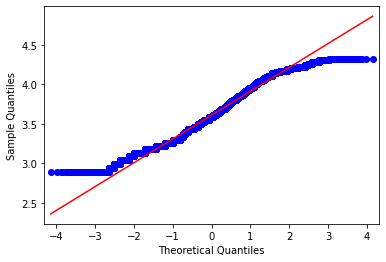

In [21]:
from statsmodels.graphics.gofplots import qqplot

qqplot(df['edad_log'], line = 's')
plt.show()

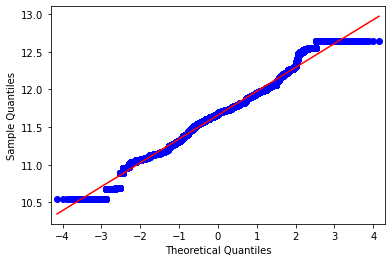

In [22]:
from statsmodels.graphics.gofplots import qqplot

qqplot(df['ingreso_log'], line = 's')
plt.show()

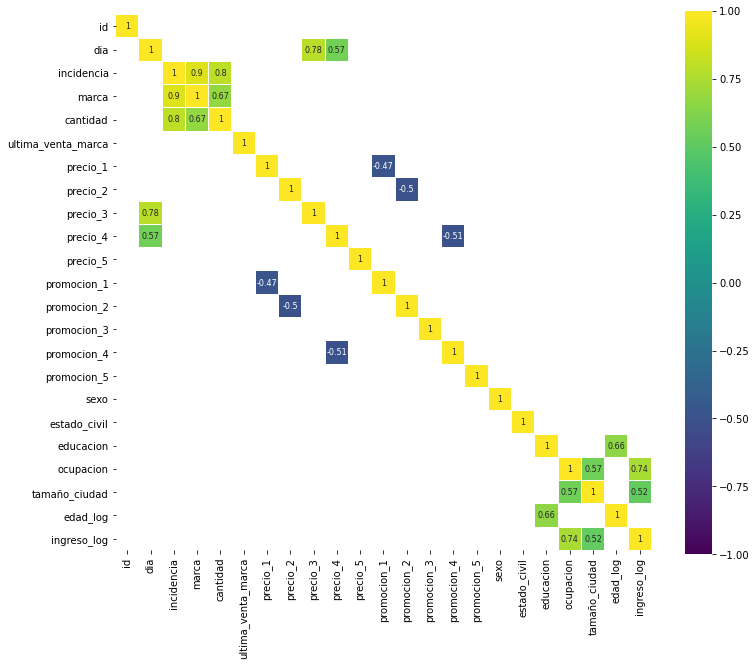

In [23]:
corr = df.drop(['edad', 'ingreso'], axis=1).corr() # We already examined SalePrice correlations
plt.figure(figsize=(12, 10))

sns.heatmap(corr[(corr >= 0.5) | (corr <= -0.4)], 
            cmap='viridis', vmax=1.0, vmin=-1.0, linewidths=0.1,
            annot=True, annot_kws={"size": 8}, square=True);